Joaquin Gutierrez.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import MeanShift


In [5]:
df = pd.read_csv('winequality-red.csv', sep = ';')

In [7]:
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


Haz un scatterplot matriz del set de datos donde las clases esten representadas concolores diferentes

c:\Users\16joa\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


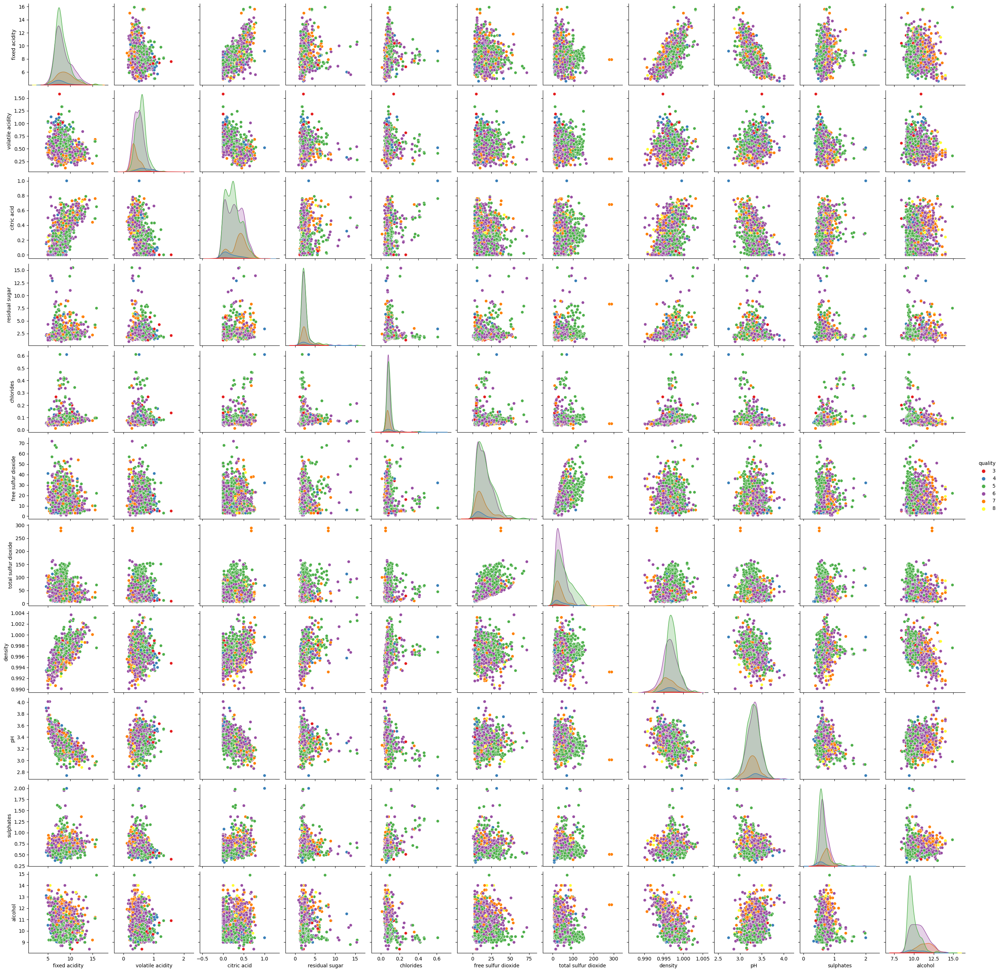

In [8]:
sns.pairplot(df, hue='quality', palette='Set1')

In [10]:
x = df.drop('quality', axis=1)
y = df['quality']

(a) Explica como funciona el método k-means.    
KMeans busca dividir una muestra de n elementos con p variables en un numero de grupos (clusters) K, el cual debemos prefijar entes de inicializar el algoritmo.        
Primero el algoritmo elige K puntos en el espacio (centroides), despues asigna cada elemento al centroid mas cercano y finalmente se mueven los contrid al promedio de cada cluster.        
Se repiten los pasos 2 y 3 hasta que los clusters no cambien o se alcance un numero n de iteraciones..

(b) Usando el método de codo encuentra el número de clusters óptimo.

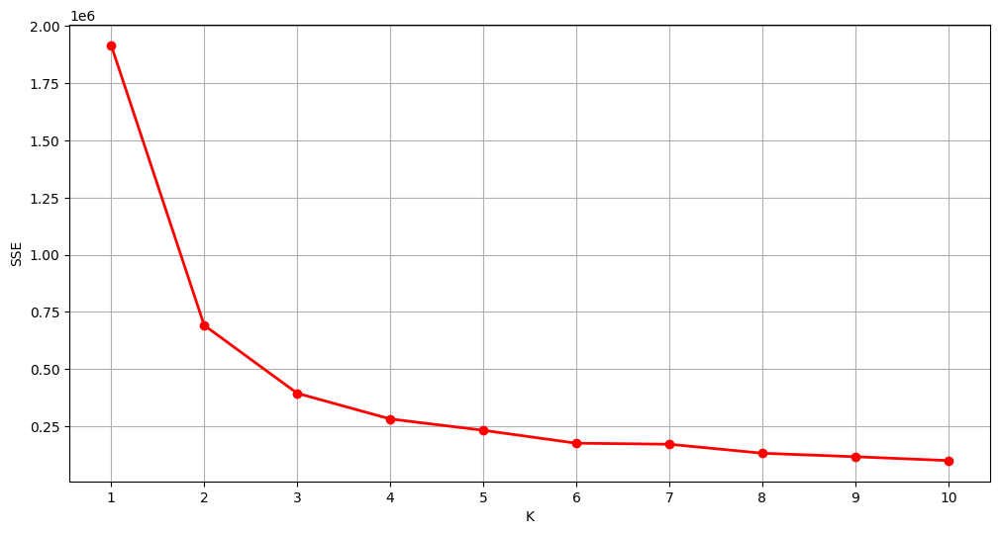

In [23]:
sse=[]
for k in range(1,11):
    kmeans= KMeans(n_clusters=k, n_init="auto")
    kmeans.fit(x)
    sse.append(kmeans.inertia_)
plt.figure(figsize=(12,6))
plt.grid()
plt.plot(range(1,11),sse,linewidth=2,color="red",marker="o")
plt.xlabel("K")
plt.xticks(np.arange(1,11,1))
plt.ylabel("SSE")
plt.show()


In [24]:
kmeans = KMeans(n_clusters=3, random_state=0).fit(x)
labels = kmeans.labels_
centroids = kmeans.cluster_centers_


c:\Users\16joa\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


(c) Considera k=numero de clases en el conjunto de datos.


In [33]:
kmeansC = KMeans(n_clusters=6, random_state=0).fit(x)
labelsC = kmeansC.labels_
centroidsC = kmeansC.cluster_centers_

print("labels", labels)
print("centroids", centroids)


labels [0 2 2 ... 2 2 2]
centroids [[8.46982759e+00 5.19519704e-01 2.68608374e-01 2.36102217e+00
  8.46059113e-02 8.99507389e+00 2.23928571e+01 9.96617512e-01
  3.31137931e+00 6.47216749e-01 1.05769294e+01]
 [7.88755187e+00 5.72365145e-01 2.75643154e-01 3.23236515e+00
  8.83983402e-02 2.61514523e+01 1.08506224e+02 9.96934730e-01
  3.28962656e+00 6.52033195e-01 1.00089212e+01]
 [8.28699634e+00 5.20503663e-01 2.72435897e-01 2.49706960e+00
  9.13095238e-02 2.15705128e+01 5.48882784e+01 9.96855769e-01
  3.32020147e+00 6.77106227e-01 1.03768010e+01]]


c:\Users\16joa\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


(d) Compara los dos modelos (b) y (c) usando Silhouette score. Cual modelo resultaen un mejor agrupamiento?         
El modelom que mejor funciona es el con K = 3, ya que segun la metrica silhouette_score es 0.51974, lo cual es mas grande que el modelo con K = numero de clases 

In [34]:
from sklearn.metrics import silhouette_score

silhouette_avgC = silhouette_score(x, labelsC, metric='euclidean')
print("silhouette_avg k numero de clases: ", silhouette_avgC)

silhouette_avg = silhouette_score(x, labels, metric='euclidean')
print("silhouette_avg k = 3:", silhouette_avg)

silhouette_avg k numero de clases:  0.44850222651946337
silhouette_avg k = 3: 0.5197446557038226


(e) Haz un scatterplot matriz del conjunto de datos para los dos modelos (b) y (c) representando los clusters con colores diferentes utilizando labels


c:\Users\16joa\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


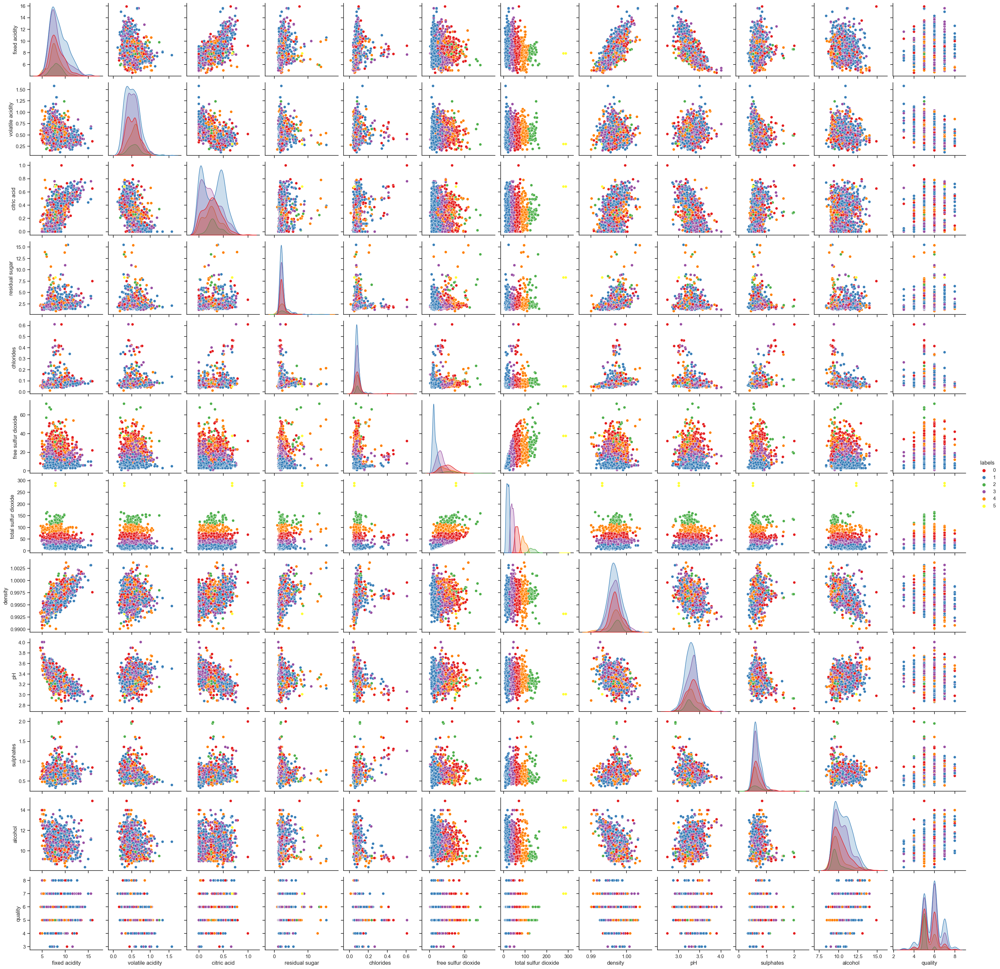

In [43]:
df['labels'] = labelsC
sns.pairplot(df, hue='labels', palette='Set1')


c:\Users\16joa\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


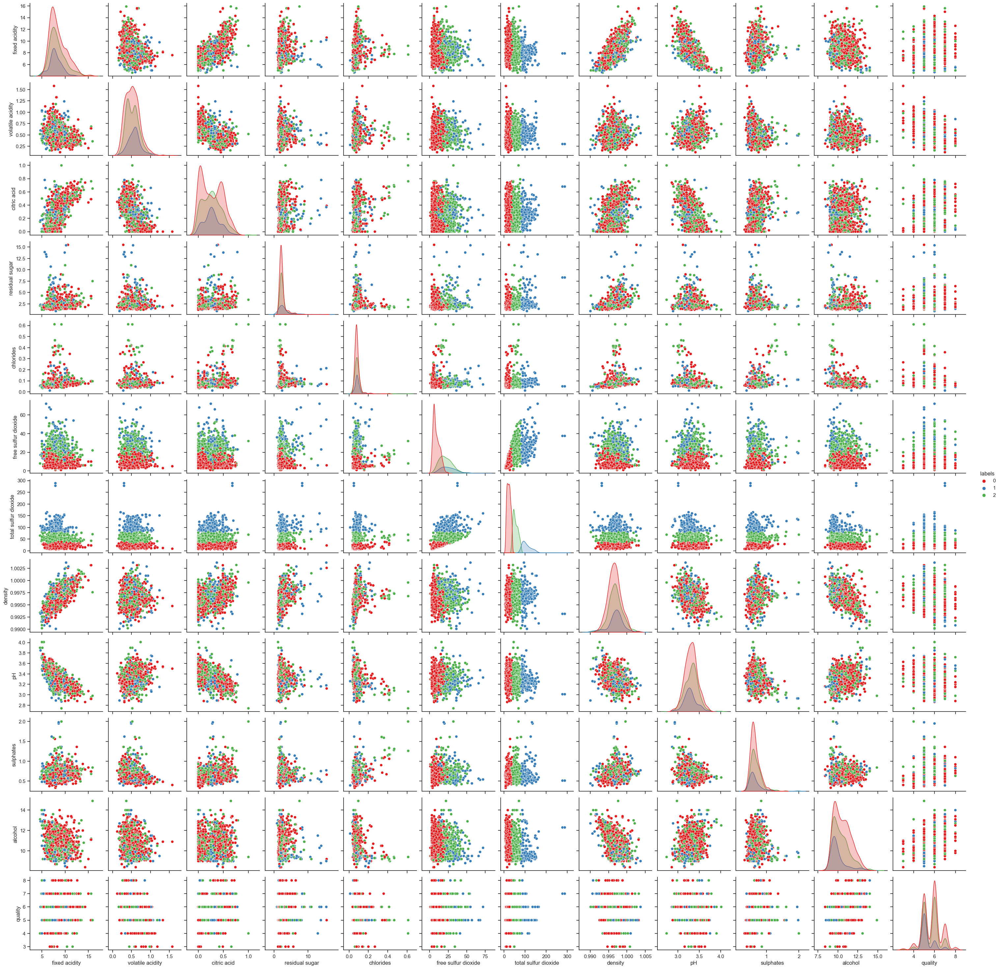

In [47]:
df['labels'] = labels
sns.pairplot(df, hue='labels', palette='Set1')

Grafica el dendograma. Qué representan los ejes horizontal y vertical del gráfico dendograma?       
El eje horizontal se ubican cada muestra individual.     
En el eje vertical se ubica la distancio entre cada muestra.     

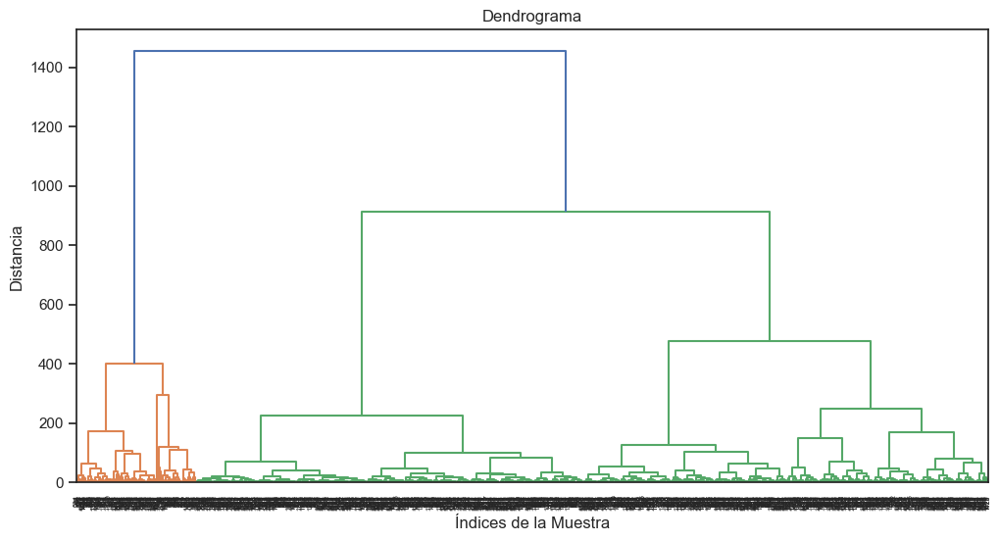

In [49]:
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt

Z = linkage(x, method='ward')

plt.figure(figsize=(12, 6))
plt.title('Dendrograma')
plt.xlabel('Índices de la Muestra')
plt.ylabel('Distancia')
dendrogram(Z)
plt.show()


(a) Basado en dendograma elige el numero de clusters        
El corte se realiza en 600 de distancia ya que a partir de ahi las distancias comienzan a ser mucho mayores, por lo que al realizar el corte quedan 3 clusters individuales.

(b) Usando este numero de clusters, utiliza el método de clustering basado en jerarquía aglomerativa y divisiva para agrupar las observaciones. Qué diferencia hay entre estés dos método jerárquicos?      
El método aglomerativo parte de cada muestra como un cluster individual, uniendo los clusters más cercanos mediante una medida de distancia hasta que todas las muestras conforman un único cluster.

El método divisivo parte de todas las muestras en un solo cluster y las va dividiendo en clusters más pequeños en cada paso. En cada iteración, se separa el cluster más grande en dos basándose en una medida de distancia, hasta que cada muestra termina en su propio cluster individual.

In [52]:

from sklearn.cluster import AgglomerativeClustering

clustering = AgglomerativeClustering(n_clusters=3).fit(x)
labelsA = clustering.labels_


In [71]:
from sklearn.cluster import BisectingKMeans

clusteringB = BisectingKMeans(n_clusters=3).fit(x)
labelsB = clusteringB.labels_

(c) Haz un scatterplot matriz del conjunto de datos para los dos modelos representando los clusters con colores distinto


c:\Users\16joa\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


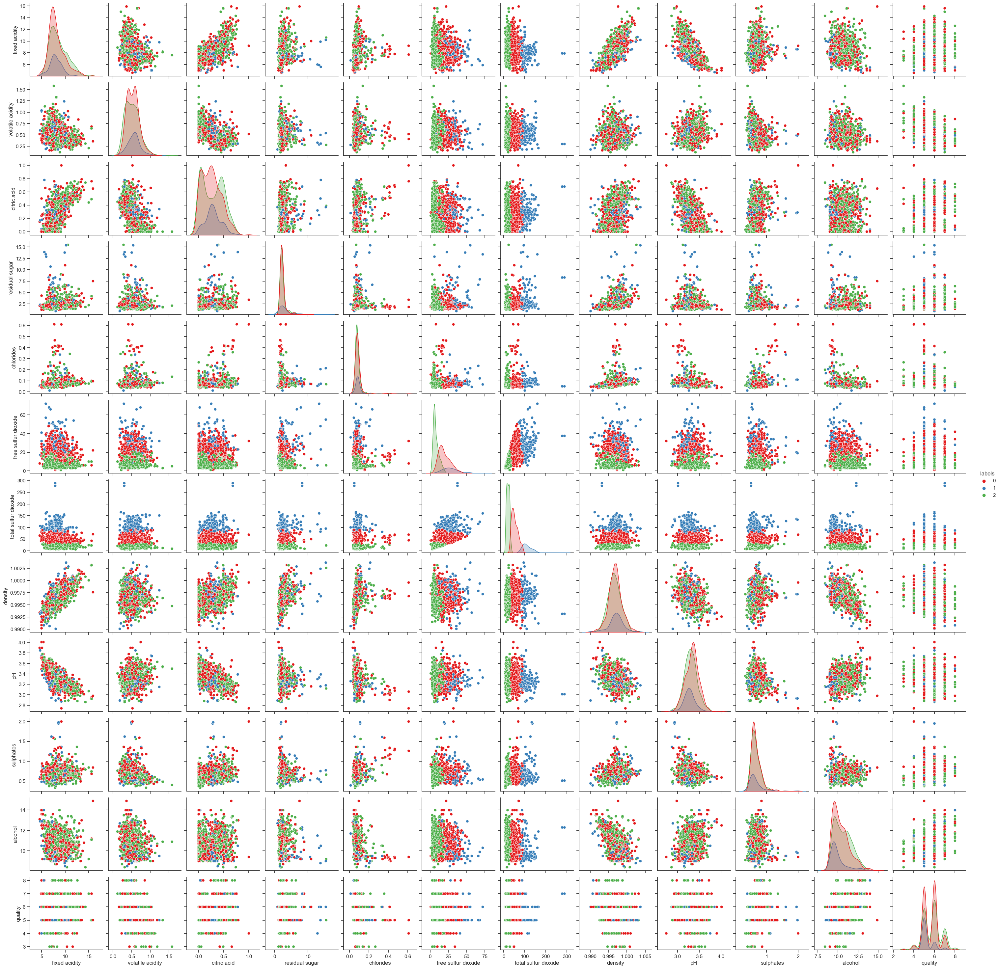

In [54]:
df['labels'] = labelsA
sns.pairplot(df, hue='labels', palette='Set1')

c:\Users\16joa\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


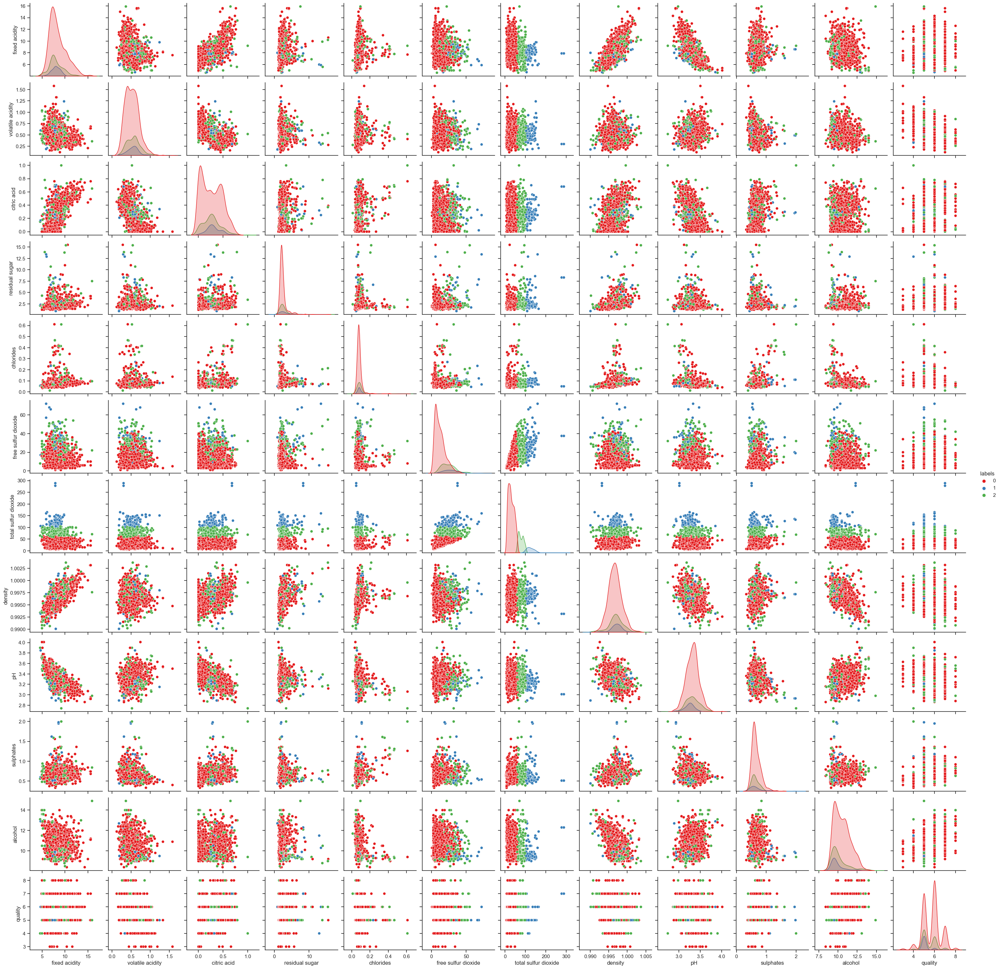

In [72]:
df['labels'] = labelsB
sns.pairplot(df, hue='labels', palette='Set1')

(a) Utiliza el método de DBSCAN para agrupar las observaciones.  

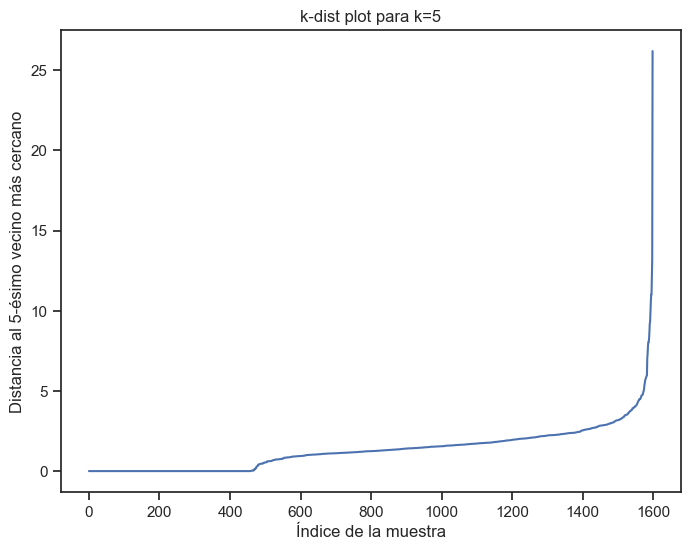

In [63]:
from sklearn.neighbors import NearestNeighbors

k = 5
nbrs = NearestNeighbors(n_neighbors=k).fit(x)
distances, _ = nbrs.kneighbors(x)
distances = np.sort(distances, axis=0)
distances = distances[:,1] 

plt.figure(figsize=(8, 6))
plt.plot(distances)
plt.xlabel('Índice de la muestra')
plt.ylabel(f'Distancia al {k}-ésimo vecino más cercano')
plt.title(f'k-dist plot para k={k}')
plt.show()


In [55]:
from sklearn.cluster import DBSCAN

epsilon = 5
minsamp = 12

model_db = DBSCAN(eps=epsilon, min_samples=minsamp).fit(x)

labelsDB = model_db.labels_

(b) Cuáles son los parámetros que tenemos que determinar en este método? Explica cada parámetro, explica también cómo podemos elegir un valor adecuado para cada parámetro y encuentra esos valores.        
Para este metodo nesesitamos un epsilon y min_samples.      
Para epsilon calculamos la distancia promedio al k-esimo vecino mas cercano para cada punto ordenados de forma ascendente y se grafica para buscar el "codo" de la grafica, lo que nos indica un buen valor para epsilon.       
Para min_samples utilizamos el numero de variables + 1

(c) Haz un scatterplot matriz del conjunto de datos.

c:\Users\16joa\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


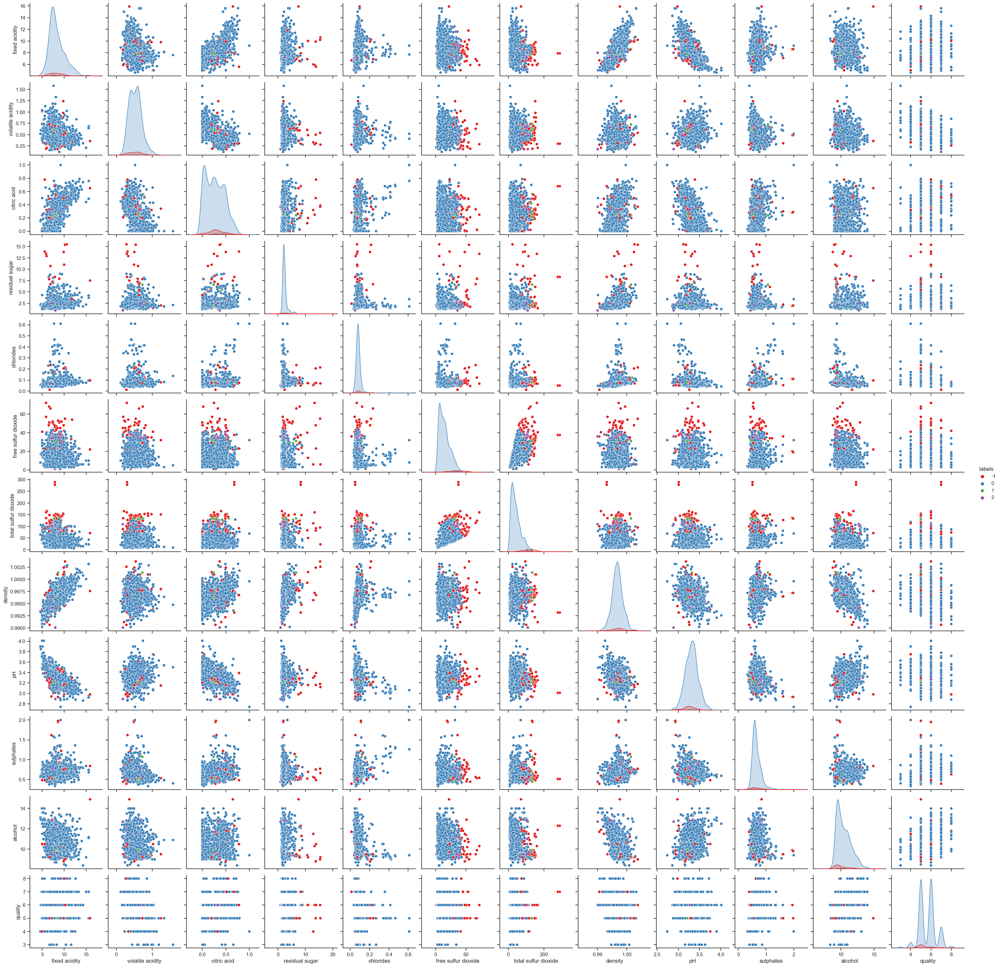

In [68]:
df['labels'] = labelsDB
sns.pairplot(df, hue='labels', palette='Set1')

(a) Utiliza el método basado en mixtura de distribuciones gausianas para agrupar las observaciones usando numero de clusters igual a numero de clases del set de datos.


In [69]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=6).fit(x)
labelsGMM = gmm.predict(x)

(b) Haz un scatterplot matriz para ver como las observaciones han agrupa

c:\Users\16joa\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


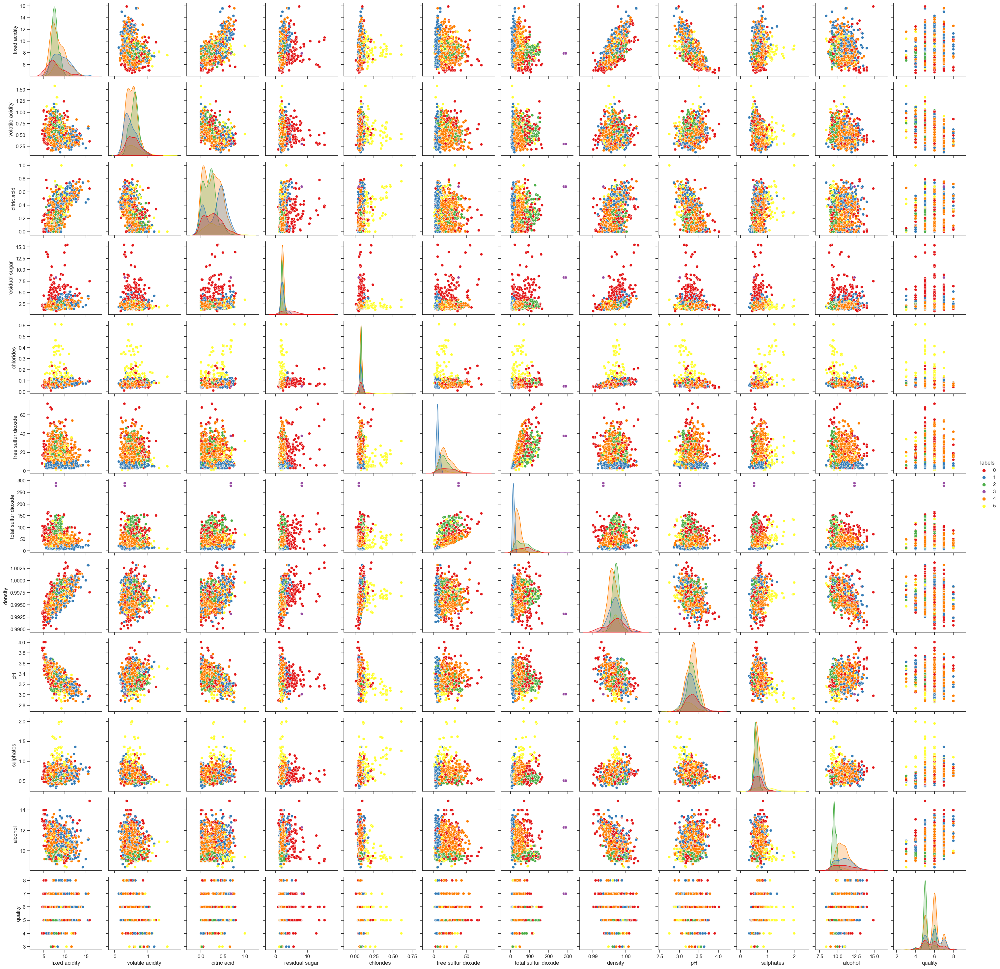

In [70]:
df['labels'] = labelsGMM
sns.pairplot(df, hue='labels', palette='Set1')